# Data Visualization Tutorial
Adapted from the documentation [here](https://github.com/lyft/nuscenes-devkit/blob/master/notebooks/tutorial_lyft.ipynb)


In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from PIL import Image
from pathlib import Path

# Load the SDK
%matplotlib inline
from lyft_dataset_sdk.lyftdataset import LyftDataset, MapMask
from lyft_dataset_sdk.utils.data_classes import LidarPointCloud
import seaborn as sns
sns.set(color_codes=True)

# Change the Dataset folder locations
Links are already created in the docker container setup
In many projects symbolic links are created to alias these required locations.

```
!ln -s /kaggle/input/3d-object-detection-for-autonomous-vehicles/train_images images
!ln -s /kaggle/input/3d-object-detection-for-autonomous-vehicles/train_maps maps
!ln -s /kaggle/input/3d-object-detection-for-autonomous-vehicles/train_lidar lidar
!ln -s /kaggle/input/3d-object-detection-for-autonomous-vehicles/train_data data

```

Unfortunately Docker may have issues with aliases so instead rename the directories you want to use.

The SDK folders that are required are images, maps, lidar, and data and they should exist inside the datasets folder 


In [3]:
df = pd.read_csv('../datasets/sample_submission.csv')

In [4]:
df.head(50)

,Id,PredictionString
0,7eb3e546df5311b035f1d4b7e88351ffdd85f311ef1bdd...,NaN
1,a76d702996a086ecd4add92b6c533b76f0ab1dd35a4729...,NaN
2,a9919963e5cd83d12b60bb9c386869ecb4dffcf2e3c401...,NaN
3,e3f42dc16cb366723699a5e12098edb56907d676cb5720...,NaN
4,033edef20c7f951738c037c0275dc02279a15454fda3e6...,NaN
5,c386141fc79587ed49ba0a9acd59c10d3d2c10e7b99479...,NaN
6,c7b0095cd5470e9a4624ebcc83fca08654c4bd4996198b...,NaN
7,f0229692c5f71e0893300e9632ff4ca2ec4e1da8fa09c5...,NaN
8,bb6a9e8ff8f6efe84f3d81232d694c42dd197dbe7749e9...,NaN
9,f6f28c11218ef22a5b18cc714e969991fb6a76d18b400d...,NaN


In [5]:
smple = pd.read_json('../datasets/test_data/sample.json')

In [6]:
smple.head(20)

,token,timestamp,next,scene_token,prev
0,a557426183b9070f94dcee13da60e9651179320651fe05...,2019-03-25 18:14:49.401841500,417ee1affe8b168760a67563e0052eb5e206a1b46482ce...,6f4302e48a14c58ad3f0ff97dea87d28080dfdf21ec28d...,7465223ebe8ace84c9da7ae3e60721b5578744ff988d73...
1,baacb26286ee508579dba5f95e56858a597be195e14ff9...,2019-02-11 23:05:43.501278500,525dce62ce6bcc17c39e6f0f98bb7c25fe1b52d7b818ee...,079be38c30f8891969b0b310249451474720b654e4c402...,7e6b22dedb9f8796e3d0133c6690b24d0e6a24d1c4f64a...
2,b8d87cee7ca49dcf1bc44ab222745b77a45dcad64a54c7...,2019-03-07 18:17:39.201667750,d7a5db6ed4eefffa39d7b7ea74777181081612dcee3bc8...,22c3f6142e24c58c098515ae425a70f6cbc1b1cfa4e8e1...,e8bb6f830ccf8e0323a4a956e5ec87e06dc6282da8806d...
3,31f05b85ddbd92d6e276005c15e8524b80ab238e4cceee...,2019-01-29 16:48:15.501051250,253fa3647259f808dd393aa6c17707ccbb25061d23d63c...,602108c20f50db0927afe6314e56af1d388067a17f4ed9...,d27da37f7c5c259be23350b35fb6f6a9f713f028d2fb8a...
4,06d26a55571e724f6dd3b7bbcae90b15926a20145e2081...,2019-01-31 18:43:42.601027250,37652fc2adbc47cd6324c8fba6a42d30f7731efd34c59e...,2739469e8f8f21d784cacf63a8c09aed06d4072ac0020b...,3401f40d509ed742885f974a327df2b71ff8be7ce12294...
5,f5b40938df64e7de43932be805761b6df8a2d46825f7b7...,2019-02-11 20:51:59.901330000,adedcc940139636f62711ad43a0fb48d023fef30e60a2b...,9c10bc8aa71c896d2495f8e7624633aa183eab7a4c2359...,1d0f636d24fb28e8b5e74461aaa63f72966b2ed97fbb45...
6,ee7992255fc45eec034f6a76c887f8ecde91b5106d0a29...,2019-02-08 19:29:19.202415000,79505f00e162a43078d351d884d94af489a48acd259d93...,6fd6462a83dd12cc9040803d21abc71cca095da5ac0e48...,c96460588d8663650943dc0a7ab6e82b5e1d0a9de4c31a...
7,c79c9d4ab87d4879c7f4f8846fc4663b9f2f7a835e65cc...,2019-03-06 21:19:09.601688250,c3874e26525632e10c4da7569cb90143c7f083f7d2c414...,8dde3aa2dde46529f5fa0fc2d7587eab5af35d8a9e168f...,a46971c2222945964841327b2f18454845118d883b7ef9...
8,2646b4c924dec95236a26dd1540b7c9b172cebe503e00b...,2019-02-01 18:01:25.601823750,0e029bfe2d8e9f91f1961f677223183d9ea0c03e4ec3b6...,a672a37273972bb70266d293a30a636664305353e2acb0...,d4170721404a15fb58a321d25e8c4a28e1c6c04ccd90c0...
9,f0e98c46fa3d69b8ff91c899537fccd4564e7123f73022...,2019-01-30 19:18:21.301776750,,bed449d2898e2f11d8d4d8a0b1b911b1050691b76dd83a...,afa4463f51a4ef36be775d6b84fe55a8a92c89a6dd0f7b...


In [7]:
# Load the SDK
%matplotlib inline
from lyft_dataset_sdk.lyftdataset import LyftDataset

# Load the dataset
# Adjust the dataroot parameter below to point to your local dataset path.
# The correct dataset path contains at least the following four folders (or similar): images, lidar, maps, v1.0.1-train
ld = LyftDataset(data_path="../datasets/", json_path="../datasets/data")
!ls ../datasets/maps
#start with test
sample_data = ld.sample[0]

# Get the meta data for the lidar data
lidar_top = ld.get('sample_data', sample_data["data"]["LIDAR_TOP"])
lidar_top

9 category,
18 attribute,
4 visibility,
18421 instance,
10 sensor,
148 calibrated_sensor,
177789 ego_pose,
180 log,
180 scene,
22680 sample,
189504 sample_data,
638179 sample_annotation,
1 map,
Done loading in 16.4 seconds.
Reverse indexing ...
Done reverse indexing in 5.5 seconds.
map_raster_palo_alto.png


{'is_key_frame': True,
 'sample_token': 'b98a05255ba2632e957884758cb31f0e6fcc8d3cd6ee76b6d0ba55b72f08fc54',
 'fileformat': 'bin',
 'token': 'ee08f2c37365e52a8982004ebb915899f2134d7a17f254fcb4137c9df30976f7',
 'prev': '7218b6be8362318863762d46a5d1479062496e9d3be059743a22776cec6f2761',
 'timestamp': 1552083686901126.0,
 'next': '8bdf7fa91e555ec8b06a359c871072a83988677b4f386266976479e77b9557a0',
 'ego_pose_token': 'f5b811274ccf4d728cff72eac31f2e25be8dce3ded559dbc13b53ace81be9785',
 'calibrated_sensor_token': '4aa35fda1166a0f588470705aa1dc3a7c52c96f08c0c4585ccfac564a0499201',
 'filename': 'lidar/host-a017_lidar1_1236118886901125926.bin',
 'sensor_modality': 'lidar',
 'channel': 'LIDAR_TOP'}

In [8]:
ld.category

[{'description': '',
  'token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
  'name': 'car'},
 {'description': '',
  'token': '73e8de69959eb9f5b4cd2859e74bec4b5491417336cad63f27e8edb8530ffbf8',
  'name': 'pedestrian'},
 {'description': '',
  'token': 'f81f51e1897311b55c0c6247c3db825466733e08df687c0ea830b026316a1c12',
  'name': 'animal'},
 {'description': '',
  'token': 'a8619a81f5acc7da2a2f034420db2b2f43a015c8c689822e5295b5d6f7a5d8d6',
  'name': 'other_vehicle'},
 {'description': '',
  'token': '7ea5868735dc408109bfa74fd139bd8c5aa3767b52e054b8e792cabcf309c6f4',
  'name': 'bus'},
 {'description': '',
  'token': '1248d937c7a1a2eb1022ba9e806ebd5183b6c20c7f5703d8a7320600f1caad27',
  'name': 'motorcycle'},
 {'description': '',
  'token': '8af78d27e148a8f544f4c86b2a3f4bd6192b975d1065dd932ebdb8879778e275',
  'name': 'truck'},
 {'token': 'c4e92c2b854fb03382838643c36d01a349f5624a11f184042d91d916d19acdbd',
  'description': '',
  'name': 'emergency_vehicle'},
 {'descriptio

In [9]:
len(ld.category)

9

In [10]:
ld.get('category', 'c4e92c2b854fb03382838643c36d01a349f5624a11f184042d91d916d19acdbd')

{'token': 'c4e92c2b854fb03382838643c36d01a349f5624a11f184042d91d916d19acdbd',
 'description': '',
 'name': 'emergency_vehicle'}

In [11]:
ld.sample_annotation[:2]

[{'token': '92bff46db1dbfc9679edc8091770c4256ac3c027e9f0a9c31dfc4fff41f6f677',
  'num_lidar_pts': -1,
  'size': [2.064, 5.488, 2.053],
  'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
  'rotation': [0.265491936795379, 0, 0, 0.964113080243515],
  'prev': 'db2c5aea69d8be40a746c5f3df9366e030189b07647212f338b31240c15896df',
  'translation': [2680.2830359778527, 698.1969292852777, -18.04776692365821],
  'num_radar_pts': 0,
  'attribute_tokens': ['1ba8c9a8bda54423fa710b0af1441d849ecca8ed7b7f9393ba1794afe4aa6aa2',
   'daf16a3f6499553cc5e1df4a456de5ee46e2e6b06544686d918dfb1ddb088f6f'],
  'next': '33e07b849d62718279c9548fe662d32247e319f0451cd461059305c3e42dcea0',
  'instance_token': 'abea2eb040d9c8fa1a44fa54020daaf9e2aa696e95e1d257481ecbf6e13a318c',
  'visibility_token': '',
  'category_name': 'car'},
 {'token': '04c4c9883de582c5c4e7a45273a978a52b0432de18883f60e7dd0e5cd2137628',
  'num_lidar_pts': -1,
  'size': [1.635, 4.339, 1.515],
  'sample_token': 'edf37

In [12]:
'# of Annotations: {}'.format(len(ld.sample_annotation))

'# of Annotations: 638179'

In [13]:
ld.get('attribute', ld.sample_annotation[3]['attribute_tokens'][0])

{'description': '',
 'token': '7fc1ca3d36808cd1858e9c01ad4e7630ff3ca9e720065034abd244122646acc8',
 'name': 'object_action_driving_straight_forward'}

# Scenes
These are some scenes in the dataset.

In [14]:
ld.scene[:2]

[{'log_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
  'first_sample_token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
  'name': 'host-a101-lidar0-1241893239199111666-1241893264098084346',
  'description': '',
  'last_sample_token': '2346756c83f6ae8c4d1adec62b4d0d31b62116d2e1819e96e9512667d15e7cec',
  'nbr_samples': 126,
  'token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100'},
 {'description': '',
  'first_sample_token': '3b30673b9d944ec6058ef5a8debb4c0a6fe075bca7076e06cf42a2bc10dc446e',
  'log_token': '0a6839d6ee6804113bb5591ed99cc70ad883d0cff396e3aec5e76e718771b30e',
  'name': 'host-a006-lidar0-1236037883198113706-1236037908098879296',
  'token': '0a6839d6ee6804113bb5591ed99cc70ad883d0cff396e3aec5e76e718771b30e',
  'last_sample_token': '5ec01e4634ca91751311eaafb45a9196ba8616bf05edc85593aff158db653a34',
  'nbr_samples': 126}]

In [15]:
'# of Scenes: {}'.format(len(ld.scene))

'# of Scenes: 180'

In [16]:
train_df = pd.read_csv('../datasets/train.csv')

In [17]:
train_df.describe()

,Id,PredictionString
count,22680,22680
unique,22680,22680
top,6fa96d033bc74807cb3a01cfa1e9b49d92f62470de1dda...,1438.007812870188 1473.3736521532942 -21.34408...
freq,1,1


In [18]:
train_df.head()

,Id,PredictionString
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2680.2830359778527 698.1969292852777 -18.04776...
1,edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e...,1208.642684768659 1585.1812946970927 -23.56236...
2,1841b7895e7163a2c1be87e8c1740e759a910cd59157b8...,848.9346793681768 2587.2870557176507 -20.15995...
3,a970c764e7abd7ebc2cc4599a6e3ae58c9773ea3c9cf1d...,1994.4320280494098 1128.30164336183 -18.054752...
4,b909de93ba19460eeea58074ccc1ef6bb302435f37b48c...,1030.3877156973385 1667.13131694941 -23.764820...


In [19]:
token = train_df.iloc[0]['Id']
token

'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341'

# Sample
Scene Keyframe. There are about 126 sampes in a given scene.

In [20]:
sample = ld.get('sample', token)
sample

{'next': 'd68e30dca1dadc71d6f15ed9c7f35cadc9c795e74fc721d668baf9753c07089e',
 'prev': 'cf9e605d1b1a1bc8d8340ad79f49c4993d75fa4171d2cad99d11a0dca5923cd5',
 'token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'scene_token': 'a9a990d6d215b494a939fba57385566732b9ce0b44b2a000fd23cc25d71cf075',
 'timestamp': 1558109692502687.0,
 'data': {'CAM_FRONT': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
  'CAM_BACK_LEFT': '521ca50fff810fcb6f70170f6a6b48709e55164902e34df1e8e3d95b5b56572e',
  'CAM_FRONT_RIGHT': 'e35731e7cc91018cbafd323f635d97ccbd948642c19937b85521bd2f9918efcc',
  'CAM_BACK': '762f245c3f3a0cfe3a9bc97eb321eb71522eaff0904469693b9c712041fcf0a1',
  'CAM_BACK_RIGHT': '89ef38638f8f4cbd932f693e934c4022681de809417a50679c9b20914286efb5',
  'LIDAR_FRONT_RIGHT': '0d3a497e9c99f8a4697e0e9d2644a8a7e3bd20143b58dba8285b63dd1715b794',
  'CAM_FRONT_LEFT': 'a8b62cfacbdb74d34051f2ace4e3e89c8eb19bab1c8830ab16a5b671a3bc9971',
  'LIDAR_TOP': 'f2f0d25a268a7a7112

# Render 3D Sample
Use SDK to render scene.

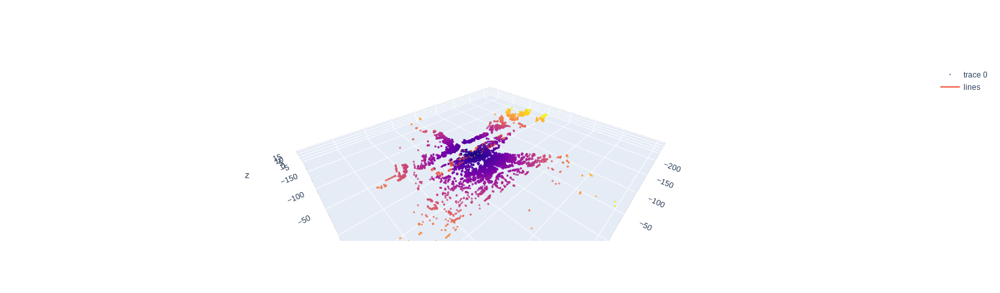

In [21]:
ld.render_sample_3d_interactive(sample['token'], render_sample=False)

In [22]:
ld.sensor

[{'modality': 'camera',
  'channel': 'CAM_FRONT_LEFT',
  'token': 'f7dad6bb70cb8e6245f96e5537e382848335872e6e259218b0a80cc071d162c4'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_LEFT',
  'token': '629da739ea3a0814b9d79ffc3b99cdbc8bdbb6f97abf139f1ad33bd12f8fa94d'},
 {'modality': 'camera',
  'channel': 'CAM_FRONT',
  'token': 'eb9e8f60a3d6e3328d7512b9f8e6800127fe91f4d62bc8e48a0e6a7cb116cc60'},
 {'modality': 'lidar',
  'channel': 'LIDAR_TOP',
  'token': '25bf751d7e35f295393d8a418731474b21c1f702e878c4553f112397caa48c08'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_LEFT',
  'token': 'c84592e22beb2c0f14d5159245ce8d6678431b879e940eed580651c09cc7d2f1'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_RIGHT',
  'token': '953faed96fd3d2fae3ec03cd2838b312b8c1a9bb7a0629481982870cb28acb67'},
 {'modality': 'camera',
  'channel': 'CAM_BACK',
  'token': '172a55e2b50f18a6b6d545369a457003c2f3b438d0180b2b4c7819ca29b3f6ab'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_RIGHT',
  'token': '8e0

In [23]:
#Check out camera data
sens = 'CAM_BACK_RIGHT'
camera = ld.get('sample_data', sample['data'][sens])
camera

{'width': 1920,
 'height': 1080,
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'token': '89ef38638f8f4cbd932f693e934c4022681de809417a50679c9b20914286efb5',
 'calibrated_sensor_token': '18908cc236587364dfac3766d0a410ef598e41a417e1cf17e3043bf50b7d600f',
 'is_key_frame': True,
 'prev': '16b78d5bedbced566516dc3468eadf0d0fef7ecf1497133c6be39e0e94f07c86',
 'fileformat': 'jpeg',
 'ego_pose_token': 'dfba284cabe099bbe89ff13355a7702828d02709f82579f1e49081479cb09dfe',
 'timestamp': 1558109692483330.0,
 'next': '9d519fd15258deeb06a40b13bdc6827a0df8fa33953e7eda88bd782089ecb936',
 'filename': 'images/host-a101_cam2_1242144892483330006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_BACK_RIGHT'}

In [24]:
img_location = '../datasets/'

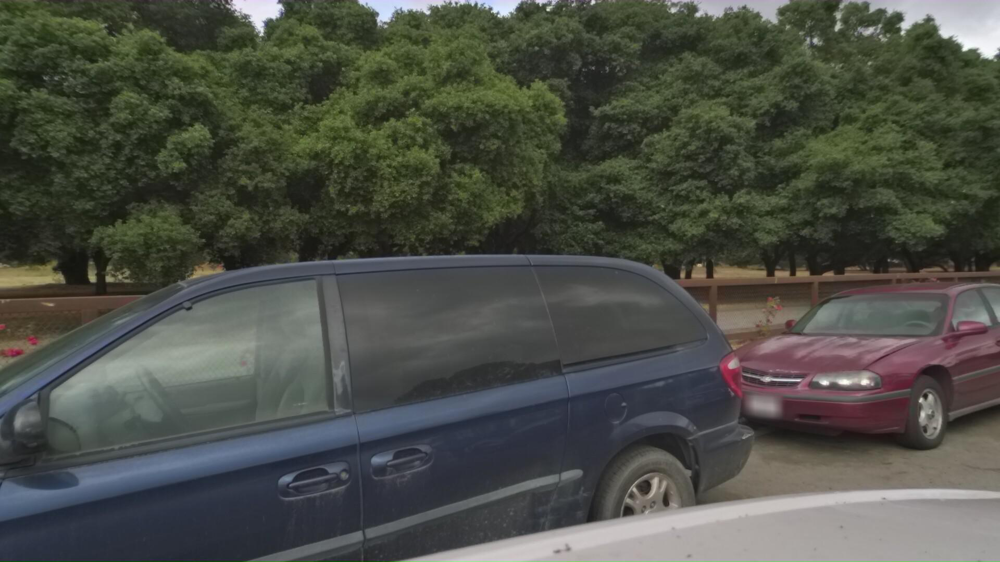

In [25]:
img = Image.open(img_location+camera['filename'])
img

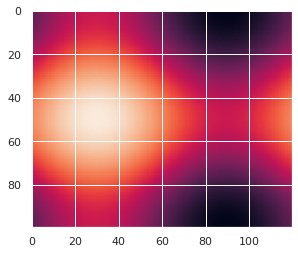

None

In [26]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

fig = plt.figure()


def f(x, y):
    return np.sin(x) + np.cos(y)

x = np.linspace(0, 2 * np.pi, 120)
y = np.linspace(0, 2 * np.pi, 100).reshape(-1, 1)
# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = []
for i in range(60):
    x += np.pi / 15.
    y += np.pi / 20.
    im = plt.imshow(f(x, y), animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

ani.save('dynamic_images.mp4')

display(plt.show())

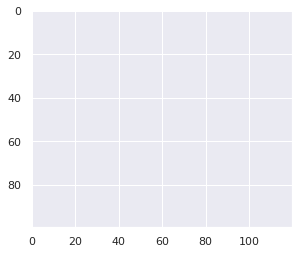

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

fig = plt.figure()


def f(x, y):
    return np.sin(x) + np.cos(y)

x = np.linspace(0, 2 * np.pi, 120)
y = np.linspace(0, 2 * np.pi, 100).reshape(-1, 1)
# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = []
for i in range(60):
    x += np.pi / 15.
    y += np.pi / 20.
    im = plt.imshow(f(x, y), animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

# ani.save('dynamic_images.mp4')

plt.show()

In [28]:
ld.scene[0]

{'log_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'first_sample_token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'name': 'host-a101-lidar0-1241893239199111666-1241893264098084346',
 'description': '',
 'last_sample_token': '2346756c83f6ae8c4d1adec62b4d0d31b62116d2e1819e96e9512667d15e7cec',
 'nbr_samples': 126,
 'token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100'}

In [29]:
token = train_df.iloc[0]['Id']
token

'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341'

In [40]:
sample = ld.get('sample', token)
sample

{'next': 'd68e30dca1dadc71d6f15ed9c7f35cadc9c795e74fc721d668baf9753c07089e',
 'prev': 'cf9e605d1b1a1bc8d8340ad79f49c4993d75fa4171d2cad99d11a0dca5923cd5',
 'token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'scene_token': 'a9a990d6d215b494a939fba57385566732b9ce0b44b2a000fd23cc25d71cf075',
 'timestamp': 1558109692502687.0,
 'data': {'CAM_FRONT': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
  'CAM_BACK_LEFT': '521ca50fff810fcb6f70170f6a6b48709e55164902e34df1e8e3d95b5b56572e',
  'CAM_FRONT_RIGHT': 'e35731e7cc91018cbafd323f635d97ccbd948642c19937b85521bd2f9918efcc',
  'CAM_BACK': '762f245c3f3a0cfe3a9bc97eb321eb71522eaff0904469693b9c712041fcf0a1',
  'CAM_BACK_RIGHT': '89ef38638f8f4cbd932f693e934c4022681de809417a50679c9b20914286efb5',
  'LIDAR_FRONT_RIGHT': '0d3a497e9c99f8a4697e0e9d2644a8a7e3bd20143b58dba8285b63dd1715b794',
  'CAM_FRONT_LEFT': 'a8b62cfacbdb74d34051f2ace4e3e89c8eb19bab1c8830ab16a5b671a3bc9971',
  'LIDAR_TOP': 'f2f0d25a268a7a7112

In [31]:
ld.sensor

[{'modality': 'camera',
  'channel': 'CAM_FRONT_LEFT',
  'token': 'f7dad6bb70cb8e6245f96e5537e382848335872e6e259218b0a80cc071d162c4'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_LEFT',
  'token': '629da739ea3a0814b9d79ffc3b99cdbc8bdbb6f97abf139f1ad33bd12f8fa94d'},
 {'modality': 'camera',
  'channel': 'CAM_FRONT',
  'token': 'eb9e8f60a3d6e3328d7512b9f8e6800127fe91f4d62bc8e48a0e6a7cb116cc60'},
 {'modality': 'lidar',
  'channel': 'LIDAR_TOP',
  'token': '25bf751d7e35f295393d8a418731474b21c1f702e878c4553f112397caa48c08'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_LEFT',
  'token': 'c84592e22beb2c0f14d5159245ce8d6678431b879e940eed580651c09cc7d2f1'},
 {'modality': 'lidar',
  'channel': 'LIDAR_FRONT_RIGHT',
  'token': '953faed96fd3d2fae3ec03cd2838b312b8c1a9bb7a0629481982870cb28acb67'},
 {'modality': 'camera',
  'channel': 'CAM_BACK',
  'token': '172a55e2b50f18a6b6d545369a457003c2f3b438d0180b2b4c7819ca29b3f6ab'},
 {'modality': 'camera',
  'channel': 'CAM_BACK_RIGHT',
  'token': '8e0

In [32]:
#Check out camera data
sens = 'CAM_FRONT'
camera = ld.get('sample_data', sample['data'][sens])
camera

{'width': 1920,
 'height': 1080,
 'sample_token': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'token': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
 'calibrated_sensor_token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'is_key_frame': True,
 'prev': 'f1c11f633b14f1d6405ce6dc83d5aa7dc4786ac1bad50588028edfca372cec7a',
 'fileformat': 'jpeg',
 'ego_pose_token': 'dfba284cabe099bbe89ff13355a7702828d02709f82579f1e49081479cb09dfe',
 'timestamp': 1558109692450000.0,
 'next': '000a8a46b2868cfa04c4d0ceaa4e082ac7bfa7eecfce8c415148c3676e9a876d',
 'filename': 'images/host-a101_cam0_1242144892450000006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

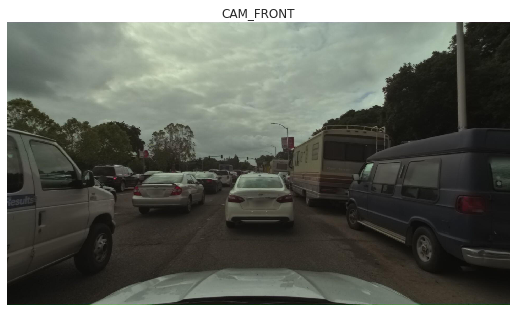

In [43]:
ld.render_sample_data(camera['next'], with_anns=False)

In [34]:
next_token = sample['next']
sample = ld.get('sample', next_token)
#Check out camera data
sens = 'CAM_FRONT'
camera = ld.get('sample_data', sample['data'][sens])
camera

{'width': 1920,
 'height': 1080,
 'sample_token': 'd68e30dca1dadc71d6f15ed9c7f35cadc9c795e74fc721d668baf9753c07089e',
 'token': '000a8a46b2868cfa04c4d0ceaa4e082ac7bfa7eecfce8c415148c3676e9a876d',
 'calibrated_sensor_token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'is_key_frame': True,
 'prev': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
 'fileformat': 'jpeg',
 'ego_pose_token': '92106ebbd05b8533d074b1974da27ab1b8f5a19e9878ec21fa7c53485973348b',
 'timestamp': 1558109692650000.0,
 'next': 'c763e065e1a37891d5fe876d6d2a1c725ec6f4076107d2b24675b167e70367a4',
 'filename': 'images/host-a101_cam0_1242144892650000006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

In [35]:
sample

{'next': '9c5726dfb8c9a82d1b4cff55ac7ab02d45f1e9a946cf27369ecc929ef7dc9500',
 'prev': 'db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce76edd4af4d04e49341',
 'token': 'd68e30dca1dadc71d6f15ed9c7f35cadc9c795e74fc721d668baf9753c07089e',
 'scene_token': 'a9a990d6d215b494a939fba57385566732b9ce0b44b2a000fd23cc25d71cf075',
 'timestamp': 1558109692702911.8,
 'data': {'CAM_BACK_RIGHT': '9d519fd15258deeb06a40b13bdc6827a0df8fa33953e7eda88bd782089ecb936',
  'CAM_BACK': '4218180552c23d4cf1d14a3ac9775ce484afc16b7284a3776156c3472aceeb54',
  'CAM_FRONT_RIGHT': '48b9a0898c2818bffb160e77d0f6cdeddd04c6a74810bf585b46715ada99bd2f',
  'LIDAR_FRONT_LEFT': 'f770104a6bbeab45c445e5e255f9fc0a3d3816fac2209f5b36fc12fa49fed641',
  'LIDAR_TOP': 'a035b707c04a511ce924bdab277378a152467c778057656389eafa27875e9468',
  'CAM_FRONT_LEFT': 'b8d65798a023e0b4e71c55a3230c747a503c080dff2c261cd061397e527271ca',
  'LIDAR_FRONT_RIGHT': 'c6cb4cef7b50bc7f733ad091aa73bd9833fde0362def2cfc156162ed04a17e2c',
  'CAM_FRONT_ZOOMED': '426fea6c

In [36]:
sens = 'CAM_FRONT'
camera = ld.get('sample_data', sample['data'][sens])
camera

{'width': 1920,
 'height': 1080,
 'sample_token': 'd68e30dca1dadc71d6f15ed9c7f35cadc9c795e74fc721d668baf9753c07089e',
 'token': '000a8a46b2868cfa04c4d0ceaa4e082ac7bfa7eecfce8c415148c3676e9a876d',
 'calibrated_sensor_token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'is_key_frame': True,
 'prev': 'bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1ebb3aa2f6bee59d1e5',
 'fileformat': 'jpeg',
 'ego_pose_token': '92106ebbd05b8533d074b1974da27ab1b8f5a19e9878ec21fa7c53485973348b',
 'timestamp': 1558109692650000.0,
 'next': 'c763e065e1a37891d5fe876d6d2a1c725ec6f4076107d2b24675b167e70367a4',
 'filename': 'images/host-a101_cam0_1242144892650000006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

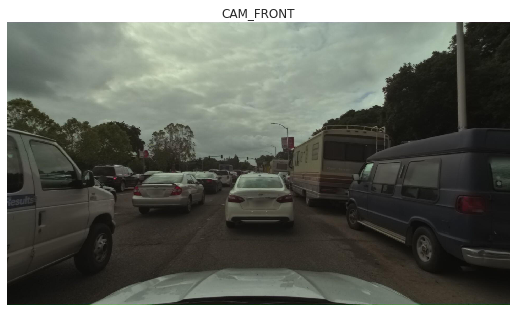

In [37]:
new_t = camera['next']
ld.render_sample_data(new_t, with_anns=False)